In [30]:
import zipfile
import pandas as pd
import os

os.getcwd()





### Read data

In [34]:
def readdata(input_path, zipfilename):
    """
    Function to extract csvs from zip file and creates dataframes. Takes the first occurence of name after "/" as the name of csv. Does not consider files in __MACOSX folder.

    Returns: dict containing all csvs
    """
    with zipfile.ZipFile(input_path + zipfilename,"r") as zip_ref:
        dfdict = {text_file.filename.split("/",1)[1]: pd.read_csv(zip_ref.open(text_file.filename))
        for text_file in zip_ref.infolist()
            if text_file.filename.endswith('.csv') and '__MACOSX' not in text_file.filename}
    return dfdict

# Load data
dict_data = readdata("../data/raw/","Data_Science_Task_2020.zip")


In [31]:
print("Customer Data")
print(dict_data['2016-09-19_79351_training.csv'].shape)
print(dict_data['2016-09-19_79351_training.csv'].head(2))

print("\n mcc data")
print(dict_data['mcc_group_definition.csv'].head(2))

print("\n Transaction Type")
print(dict_data['transaction_types.csv'].head(2))

Customer Data
(408546, 7)
                            user_id transaction_date transaction_type  \
0  a78884f5e76951188c1e719d4956773a       2016-02-01               DT   
1  b0333294fef6ff1299102a70ad46b126       2016-02-01               DT   

   mcc_group  amount_n26_currency dataset_transaction dataset_user  
0        NaN                  350            training     training  
1        NaN                  202            training     training  

 mcc data
   mcc_group explanation
0          1         ATM
1          2   Groceries

 Transaction Type
  type            explanation direction agent
0   AR   Authorization reject         -  Card
1   AE  Authorization expired        In  Card


In [35]:
for key in dict_data:
    print(f"Number of Duplicates to be removed in {key}: {dict_data[key].duplicated().sum()}")
    dict_data[key].drop_duplicates(inplace=True)
    

Number of Duplicates to be removed in mcc_group_definition.csv: 0
Number of Duplicates to be removed in 2016-09-19_79351_training.csv: 10225
Number of Duplicates to be removed in transaction_types.csv: 0


In [38]:
for key in dict_data:
    print(f" \n\nCount total NaN at each column in {key} : \n",
        dict_data[key].isnull().sum())



Count total NaN at each column in mcc_group_definition.csv : 
 mcc_group      0
explanation    0
dtype: int64
 

Count total NaN at each column in 2016-09-19_79351_training.csv : 
 user_id                     0
transaction_date            0
transaction_type            0
mcc_group              146730
amount_n26_currency         0
dataset_transaction         0
dataset_user                0
dtype: int64
 

Count total NaN at each column in transaction_types.csv : 
 type           0
explanation    0
direction      0
agent          0
dtype: int64


### Missing Values

Except for mcc group the data seems to be clean

### Merging customer transaction data with transaction type

In [123]:
# Merging dataframe with transaction type and MCC
df_complete = dict_data['2016-09-19_79351_training.csv'] \
.merge(dict_data['transaction_types.csv'], how="left", left_on="transaction_type",  right_on="type" ) \
.rename(columns={'explanation':'explanation_mcc'}) \
.merge(dict_data['mcc_group_definition.csv'], how="left", on="mcc_group") \
.rename(columns={'explanation':'explanation_transaction_type'}) \
.get(["user_id","transaction_date","amount_n26_currency","explanation_mcc","direction","agent","explanation_transaction_type"])

# Exporting the dataframe to csv in interim folder
df_complete.to_csv("../data/interim/df_complete.csv", index=False)

### Clustering to segment types of customer based on the transaction

In [126]:
df_complete.head(2)

,user_id,transaction_date,amount_n26_currency,explanation_mcc,direction,agent,explanation_transaction_type
0,a78884f5e76951188c1e719d4956773a,2016-02-01,350,Debit Transfer,Out,Bank Account,NaN
1,b0333294fef6ff1299102a70ad46b126,2016-02-01,202,Debit Transfer,Out,Bank Account,NaN


In [127]:
df_complete.describe()

,amount_n26_currency
count,398321.000000
mean,53.142792
std,112.664374
min,3.000000
25%,7.000000
50%,17.000000
75%,38.000000
max,1166.000000


In [193]:
def get_user_total_trx_count(tmp_df):
    '''
    Description: Returns monthly average number of transactions 

    Returns: DataFrame
    '''

    df_complete['month'] = pd.DatetimeIndex(df_complete['transaction_date']).month
    return tmp_df['user_id'].value_counts().to_frame().rename(columns={'user_id':'num_of_transactions'})

def get_user_total_expense_count(tmp_df,normalize=False):
    '''
    Description: Returns count income (IN) and expense (OUT) for each user

    Returns: DataFrame
    '''
    return pd.crosstab(tmp_df['user_id'], tmp_df['direction'],normalize=normalize).round(2)

def get_user_monetary_total(tmp_df, stat, normalize=False):
    '''
    Description: Returns total income and expenses

    Params:
        stat: Different agg functions like mean, median 
    '''
    return pd.crosstab(tmp_df['user_id'], tmp_df['direction'],tmp_df['amount_n26_currency'],normalize=normalize, aggfunc=stat).round(2)



In [194]:
df_complete['month'] = pd.DatetimeIndex(df_complete['transaction_date']).month

In [212]:
dfx = get_user_total_trx_count(df_complete).join(get_user_total_expense_count(df_complete,normalize=False)) \
.rename(columns={'In':'num_incoming_transactions','Out':'num_outgoing_transactions'}) \
.join(get_user_monetary_total(df_complete,'sum',normalize=False)) \
.rename(columns={'In':'sum_income','Out':'sum_expense'}) \
.join(df_complete.groupby(['user_id'])['month'].nunique().reset_index().set_index('user_id'))





In [229]:
dfx['avg_monthly_incoming_trx'] = (dfx['num_incoming_transactions']/dfx['month']).round(0)
dfx['avg_monthly_outgoing_trx'] = (dfx['num_outgoing_transactions']/dfx['month']).round(0)
dfx['avg_monthly_incoming_amt'] = (dfx['sum_income']/dfx['month']).round(2)
dfx['avg_monthly_outgoing_trx'] = (dfx['sum_expense']/dfx['month']).round(2)
dfx = dfx.get(['avg_monthly_incoming_trx','avg_monthly_outgoing_trx','avg_monthly_incoming_amt','avg_monthly_outgoing_trx'])

In [235]:
from scipy.stats import zscore
mydata_z = dfx.fillna(0).apply(zscore)



In [240]:
from sklearn.cluster import KMeans
# List to store cluster and intra cluster distance
clusters = []
inertia_vals = []
# Since creating one cluster is similar to observing the data as a whole, multiple values of K are utilized to come up with the optimum cluster value
#Note: Cluster number and intra cluster distance is appended for plotting the elbow curve
for k in range(1, 10, 1):
    
    # train clustering with the specified K
    model = KMeans(n_clusters=k, random_state=7, n_jobs=10)
    model.fit(mydata_z)
# append model to cluster list
    clusters.append(model)
    inertia_vals.append(model.inertia_)

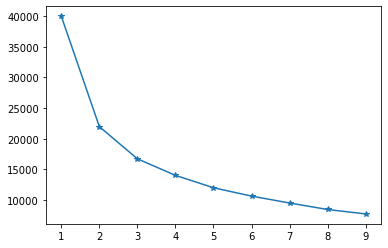

In [241]:
# plot the inertia vs K values
plt.plot(range(1,10,1),inertia_vals,marker='*')
plt.show()

In [242]:
from sklearn.metrics import silhouette_score
for i in range(1,9,1):
    
    print("---------------------------------------")
    print(clusters[i])
    print("Silhouette score:",silhouette_score(mydata_z, clusters[i].predict(mydata_z)))

---------------------------------------
KMeans(n_clusters=2, n_jobs=10, random_state=7)
Silhouette score: 0.6358610711705692
---------------------------------------
KMeans(n_clusters=3, n_jobs=10, random_state=7)
Silhouette score: 0.5424036018337866
---------------------------------------
KMeans(n_clusters=4, n_jobs=10, random_state=7)
Silhouette score: 0.45760286238568915
---------------------------------------
KMeans(n_clusters=5, n_jobs=10, random_state=7)
Silhouette score: 0.4442031146715428
---------------------------------------
KMeans(n_clusters=6, n_jobs=10, random_state=7)
Silhouette score: 0.3781520626122985
---------------------------------------
KMeans(n_clusters=7, n_jobs=10, random_state=7)
Silhouette score: 0.4073725104704882
---------------------------------------
KMeans(n_jobs=10, random_state=7)
Silhouette score: 0.3766431186883649
---------------------------------------
KMeans(n_clusters=9, n_jobs=10, random_state=7)
Silhouette score: 0.3796819334495466


In [245]:
    model = KMeans(n_clusters=7, random_state=7, n_jobs=10)
    model.fit(mydata_z)


KMeans(n_clusters=7, n_jobs=10, random_state=7)

In [244]:
clusters

[KMeans(n_clusters=1, n_jobs=10, random_state=7),
 KMeans(n_clusters=2, n_jobs=10, random_state=7),
 KMeans(n_clusters=3, n_jobs=10, random_state=7),
 KMeans(n_clusters=4, n_jobs=10, random_state=7),
 KMeans(n_clusters=5, n_jobs=10, random_state=7),
 KMeans(n_clusters=6, n_jobs=10, random_state=7),
 KMeans(n_clusters=7, n_jobs=10, random_state=7),
 KMeans(n_jobs=10, random_state=7),
 KMeans(n_clusters=9, n_jobs=10, random_state=7),
 KMeans(n_clusters=7, n_jobs=10, random_state=7)]

In [246]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler


In [248]:
scaler = StandardScaler()
X_scale = scaler.fit_transform(dfx.fillna(0))

In [252]:
cluster_range = range(1,10)
cluster_errors = []

for num_clusters in cluster_range:
    clusters = KMeans(num_clusters)
    clusters.fit(X_scale)
    cluster_errors.append(clusters.inertia_)


In [253]:
cluster_errors

[39999.99999999986,
 21980.231525493935,
 16724.375558678064,
 14020.73474577572,
 12000.625922652043,
 10633.584883635876,
 9491.602170691074,
 8462.458000228837,
 7621.9051070341775]

In [254]:
# Calculate Silhoutte Score
#
score = silhouette_score(X_scale, km.labels_, metric='euclidean'

SyntaxError: unexpected EOF while parsing (<ipython-input-254-cd27f70bed28>, line 3)

For n_clusters = 2 The average silhouette_score is : 0.6358610711705692
For n_clusters = 3 The average silhouette_score is : 0.5435253257151039
For n_clusters = 4 The average silhouette_score is : 0.45512484109324297
For n_clusters = 5 The average silhouette_score is : 0.4442031146715428
For n_clusters = 6 The average silhouette_score is : 0.37601357918603057
For n_clusters = 7 The average silhouette_score is : 0.40425284442156006
For n_clusters = 8 The average silhouette_score is : 0.36167183134686576
For n_clusters = 9 The average silhouette_score is : 0.3829399552638909
For n_clusters = 10 The average silhouette_score is : 0.3852925106568639


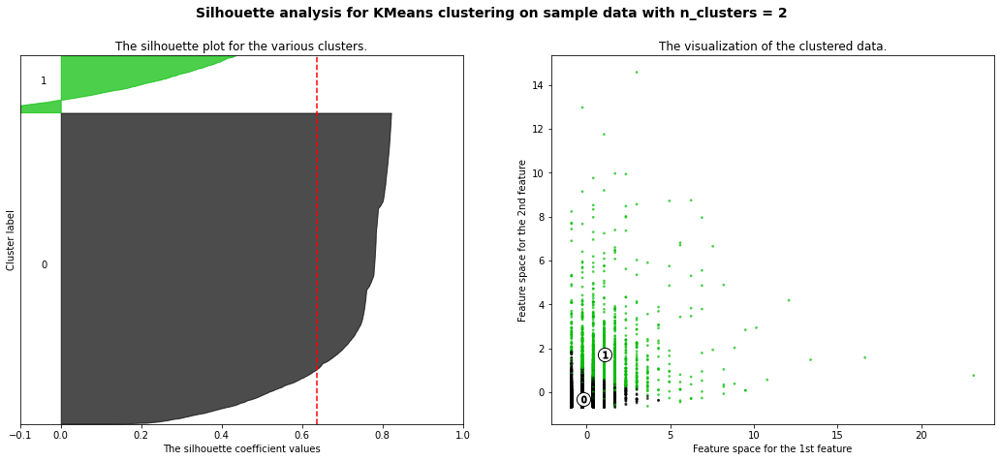

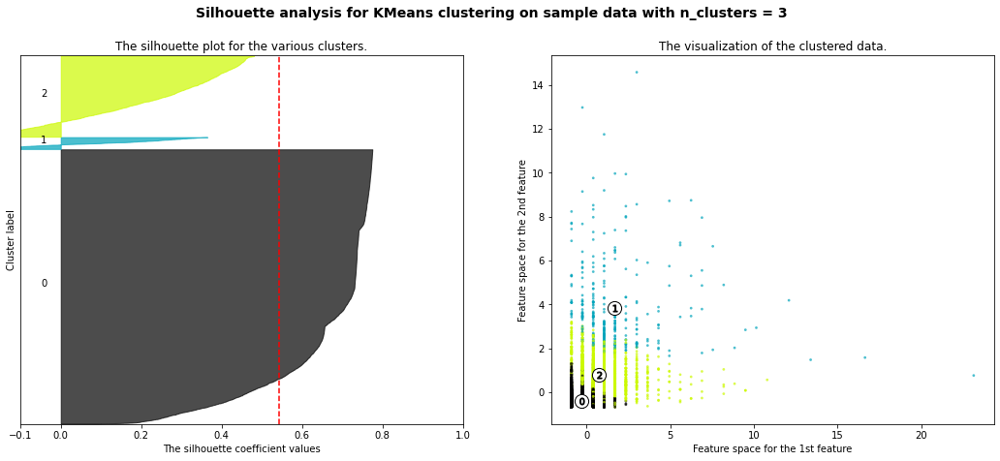

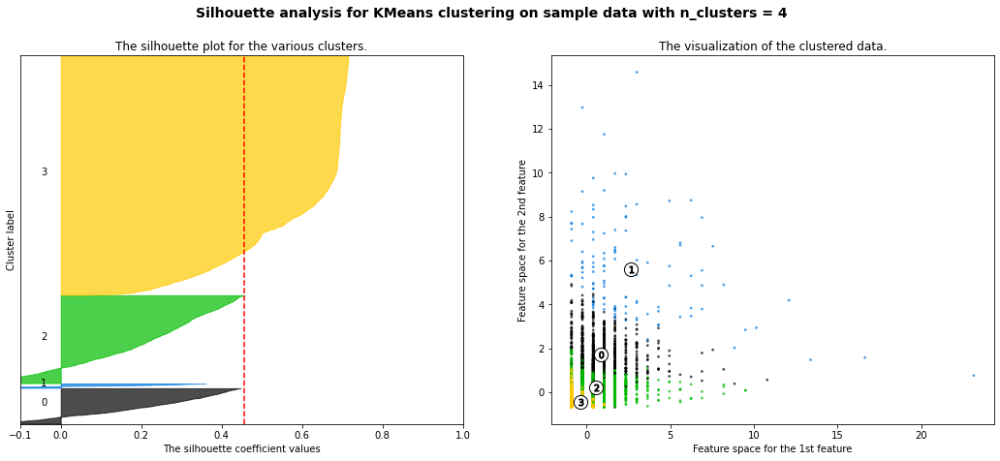

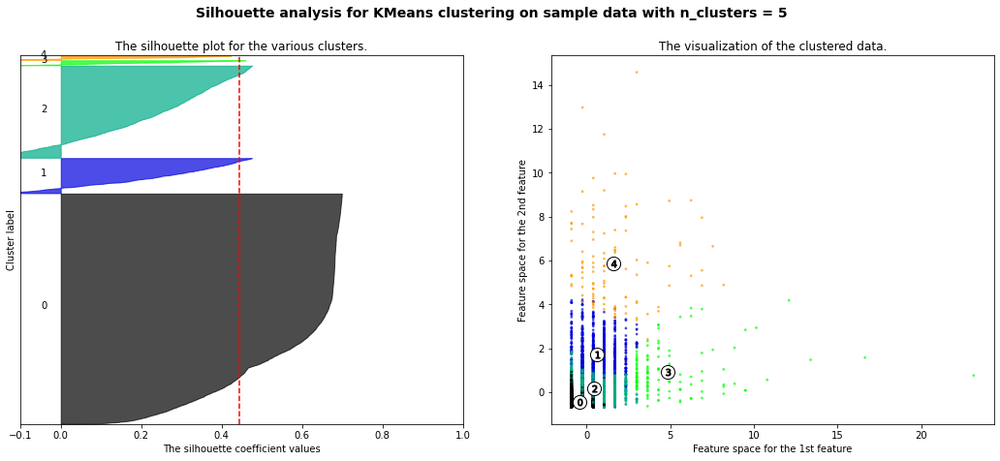

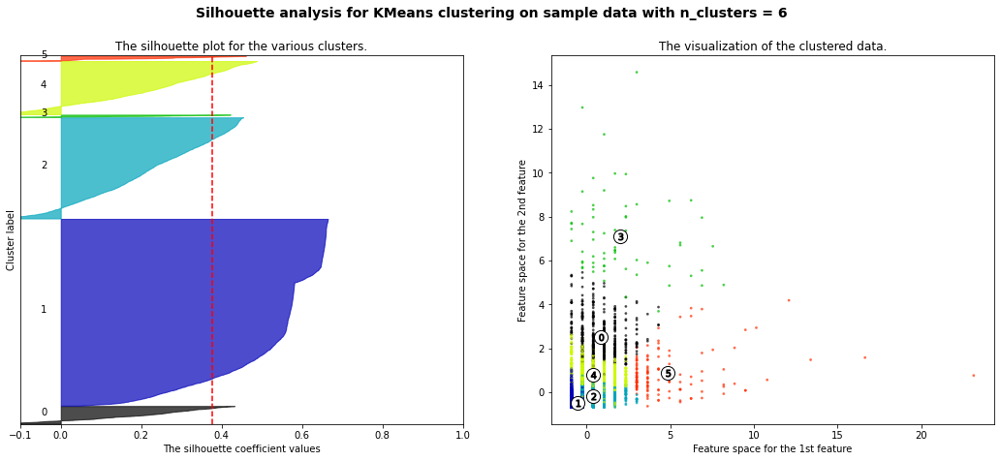

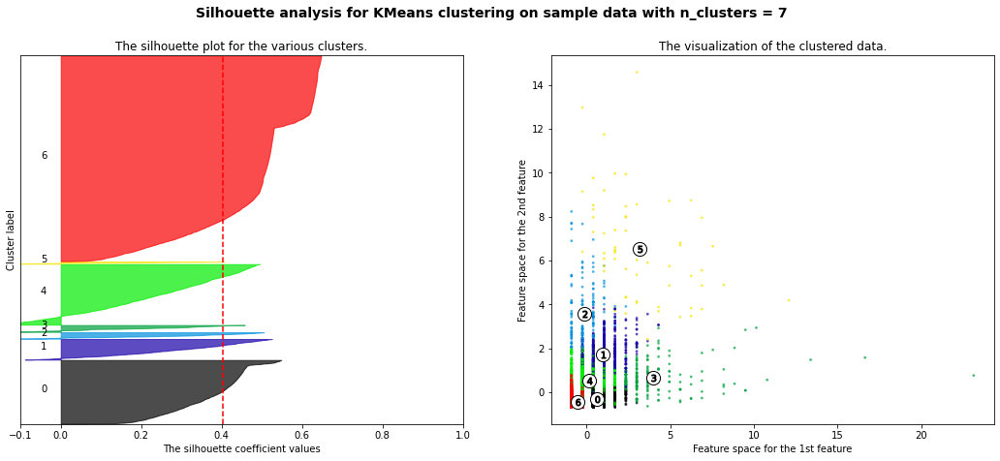

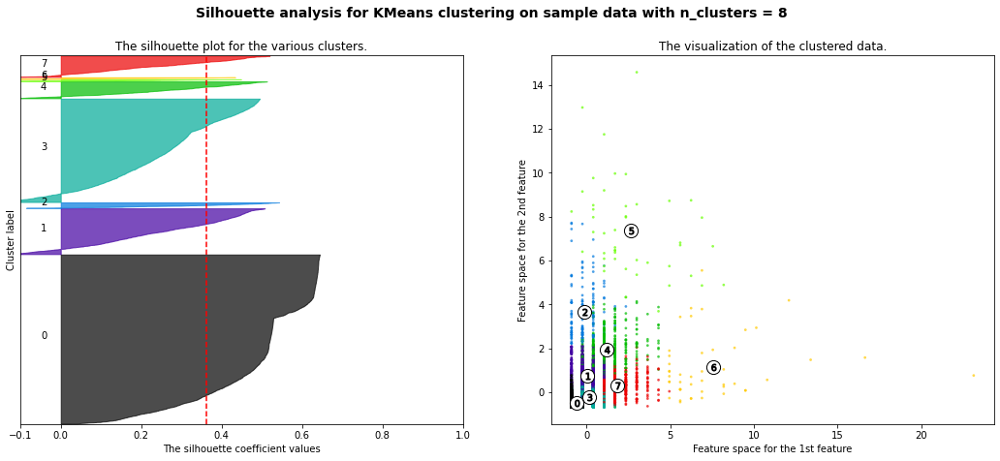

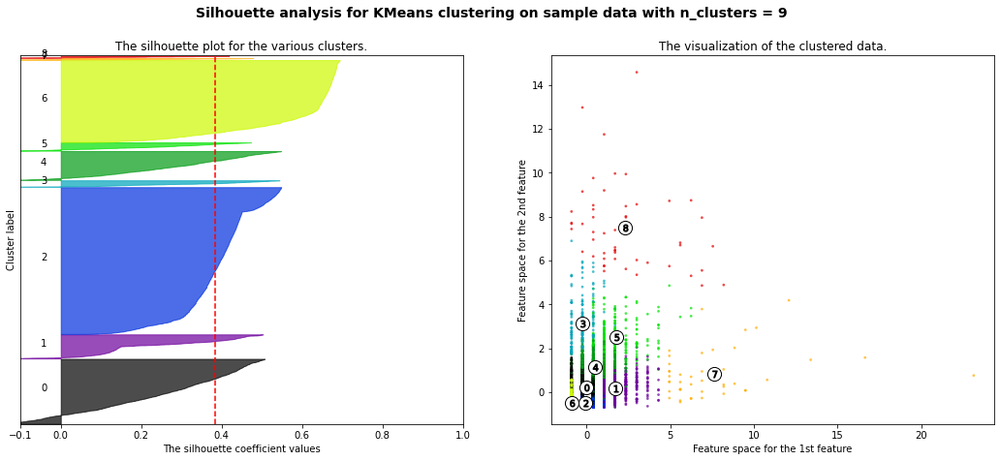

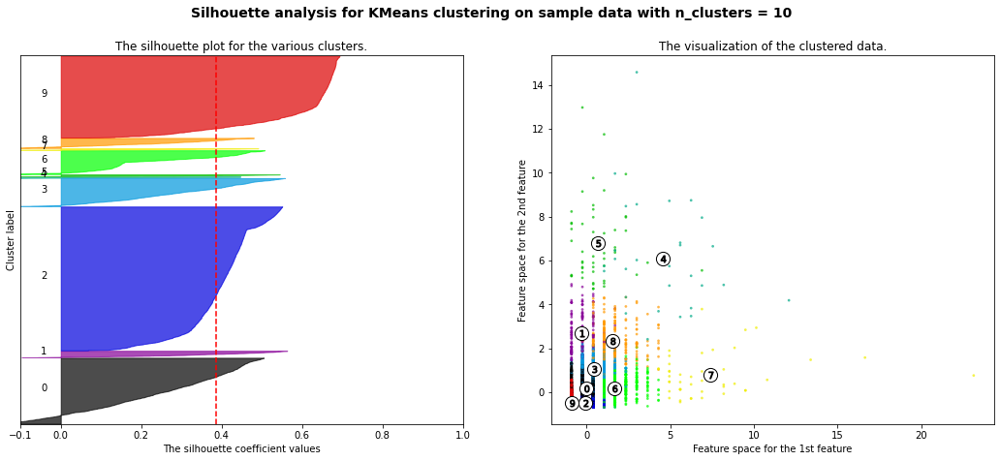

In [258]:
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.cm as cm
range_n_clusters = [2, 3, 4, 5, 6,7,8,9,10]
X = X_scale
for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()
